In [3]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import scipy
import statsmodels.api as sm
import pandas as pd
import pfTent as tent
import simulateParams as sTent
import plotting as pt
import os

In [4]:
os.chdir('/Users/cwagner2/Work/projects/malaria/pf-longitudinal-antigens/immunity-sims/pf-tent/') 

In [5]:
outcomeLabels = ["Median parasite density",
                 "Mean parasite density",
                 "Median infection length",
                 "Mean infection length",
                 "Median MOI",
                 "Mean MOI",
                 "Percent with parasitemia",
                 "Malaria cases",
                 "Day of first asymptomatic",
                 "Day of last malaria",
                 "Days between first asymptomatic & last malaria",
                 "Average parasite density peaks between first asymptomatic & last malaria",
                 "% microscopy positive during inbetween",
                 "% parasite density > 1 during inbetween",
                 "Cases in Year 1",
                 "Cases in Year 2",
                 "Cases in Year 3",
                 "Cases in Year 4",
                 "Cases in Year 5",
                 "% microscopy positive in Year 1",
                 "% microscopy positive in Year 2",
                 "% microscopy positive in Year 3",
                 "% microscopy positive in Year 4",
                 "% microscopy positive in Year 5",
                 "% pdensity > 1 in Year 1",
                 "% pdensity > 1 in Year 2",
                 "% pdensity > 1 in Year 3",
                 "% pdensity > 1 in Year 4",
                 "% pdensity > 1 in Year 5",
                 "Average pdens in Year 1",
                 "Average pdens in Year 2",
                 "Average pdens in Year 3",
                 "Average pdens in Year 4",
                 "Average pdens in Year 5",
                 "% symptomatic in Year 1",
                 "% symptomatic in Year 2",
                 "% symptomatic in Year 3",
                 "% symptomatic in Year 4",
                 "% symptomatic in Year 5",
                 "Meets criteria?"
                ]
outcomeLog = [True,True, False, False, False, False, False, False, False, False, False, True, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, True, True, True, True, True, False, False, False, False, False, False]
n_people = 100
pvalues = ["Immune half-life",
           "xh: % immunity inflection",
           "Duration of infection",
           "Max parasitemia",
           "Number of Alleles",
           "EIR",
           "Number of loci",
           "Variance in max parasitemia",
           "Liver stage immunity"
          ]
sig = 0.05

In [6]:
lowess = sm.nonparametric.lowess

def plot(arr,ylab, logy, intervals,n_people,xlab,logx=False):
    '''
    Plots results of banding
    '''
    x = np.repeat(intervals,n_people)
    flattened = arr[:,:].flatten('F')
    smoothed = lowess(flattened, x, return_sorted=True, frac=0.25)
    fig, ax = plt.subplots(tight_layout=True, figsize=(6,4))
    ax.scatter(x, flattened, alpha=0.01)
    ax.plot(smoothed[:,0],smoothed[:,1], color='black')
    if logy == True:
        ax.set_yscale('log')
    if logx == True:
        ax.set_xscale('log')
    ax.set_xlabel(xlab)
    ax.set_ylabel(ylab)

In [7]:
with open('output/params.npy', 'rb') as f:
    params = np.load(f)
with open('output/sims.npy', 'rb') as f:
    sims = np.load(f)

In [8]:
params.shape

(10000, 9)

In [36]:
def plot_goodbad(good,bad,locs=[5,4,6]):
    for value in locs:
        fig,ax = plt.subplots(nrows=2,ncols=4,figsize=(13,6), tight_layout=True)
        i = 0
        for lab, p in zip(pvalues,range(14)):
            if p!=value:
                row = int(np.floor(i/4))
                col = i % 4
                ax[row,col].scatter(params[bad,value],params[bad,p],s=5,c='orange',alpha=0.5)
                ax[row,col].scatter(params[good,value],params[good,p],c='blue',s=5,alpha=0.5)
                ax[row,col].set_ylabel(lab)
                ax[row,col].set_xlabel(pvalues[value])
                i+= 1

In [37]:
good = []
bad = []
n_sims,n_params = params.shape
for row in np.arange(n_sims):
    y_c = sims[14+(5*4):14+(5*5),:,row].flatten()
    y_p = sims[14+(5*3):14+(5*4),:,row].flatten()
    x = np.broadcast_to(np.arange(1,6),(100,5)).T.flatten()
    results_c = scipy.stats.linregress(x,y_c,alternative='less')
    results_p = scipy.stats.linregress(x,y_p,alternative='less')
    final_cases = np.mean(sims[-2,:,row])
    ilength = np.mean(sims[3,:,row])
    if results_c.pvalue < sig and results_p.pvalue < sig and final_cases > 0 and ilength > 10:
        good.append(row)
    else:
        bad.append(row)

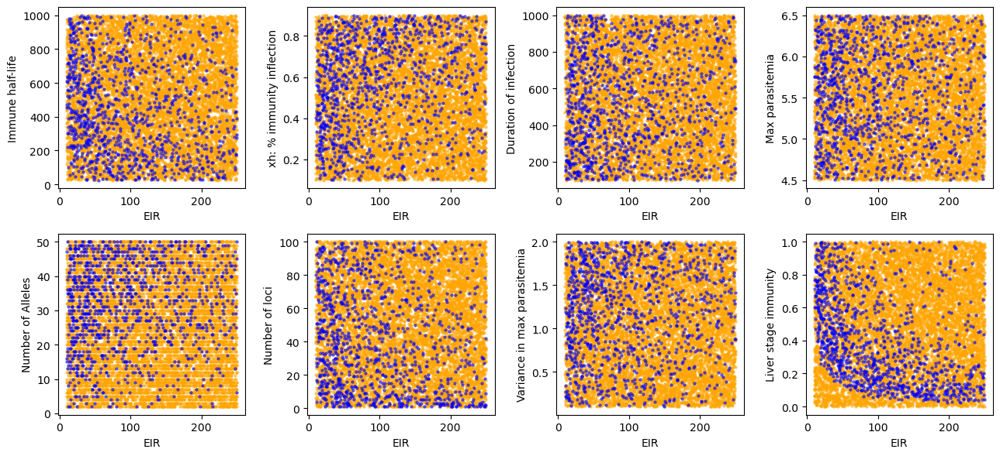

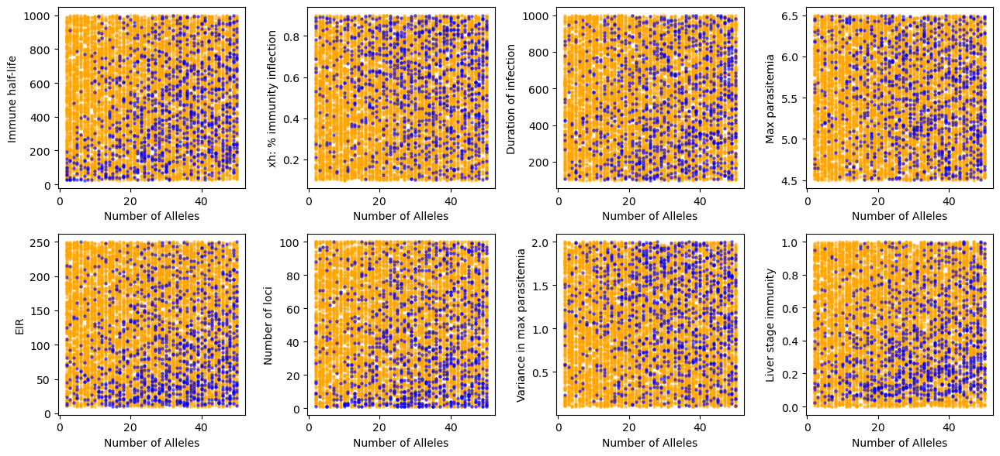

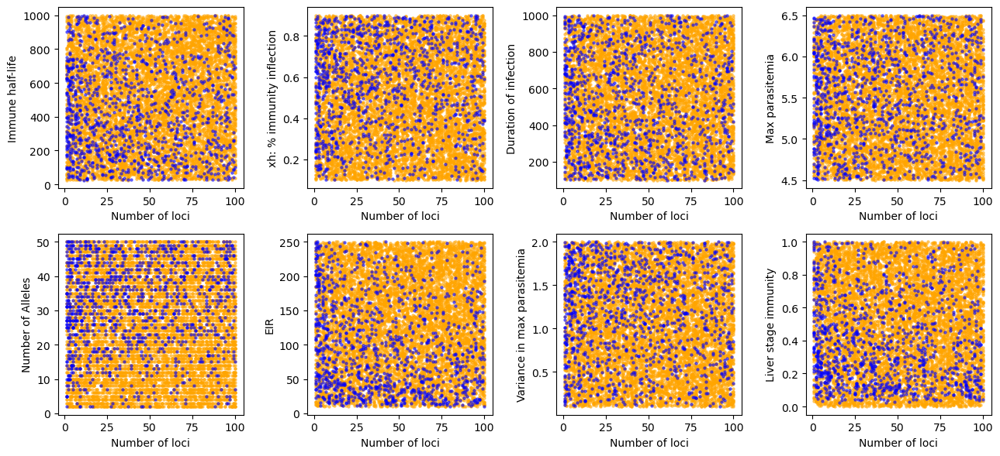

In [38]:
plot_goodbad(good,bad)

In [39]:
good = []
bad = []
n_sims,n_params = params.shape
for row in np.arange(n_sims):
    y_c = sims[14+(5*4):14+(5*5),:,row].flatten()
    y_p = sims[14+(5*3):14+(5*4),:,row].flatten()
    x = np.broadcast_to(np.arange(1,6),(100,5)).T.flatten()
    results_c = scipy.stats.linregress(x,y_c,alternative='less')
    results_p = scipy.stats.linregress(x,y_p,alternative='less')
    final_cases = np.mean(sims[-2,:,row])
    ilength = np.mean(sims[3,:,row])
    if results_c.pvalue < sig and results_p.pvalue < sig and final_cases > 0 and ilength > 10 and params[row,0]<400 and params[row,0]>150 and params[row,1]>0.6 and params[row,1]<0.8 and params[row,8]>0.35 and params[row,8]<0.5 and params[row,7]>1 and params[row,3]>5 and params[row,3]<6:
        good.append(row)
    elif params[row,0]<400 and params[row,0]>150 and params[row,1]>0.6 and params[row,1]<0.8 and params[row,8]>0.35 and params[row,8]<0.5 and params[row,7]>1 and params[row,3]>5 and params[row,3]<6:
        bad.append(row)

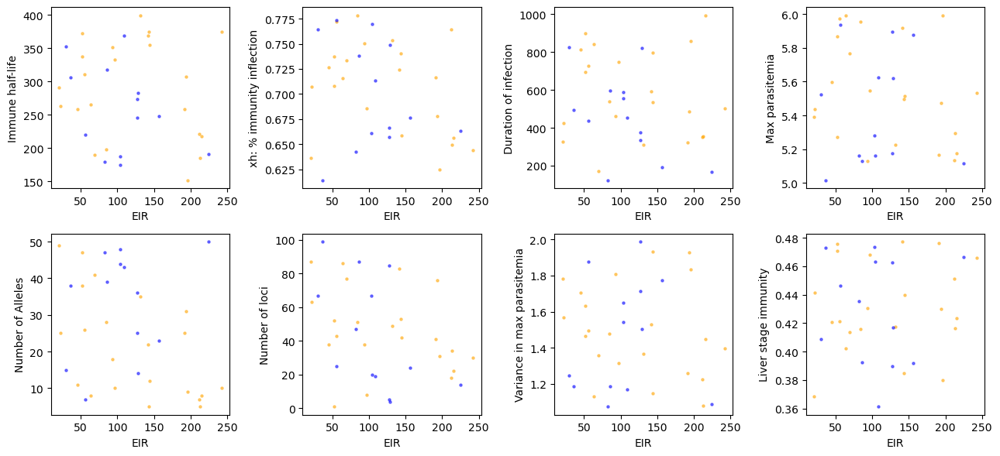

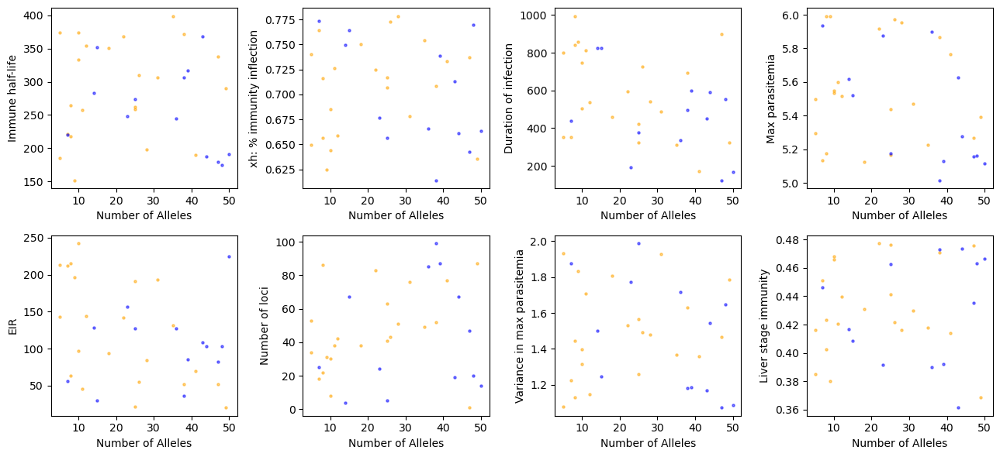

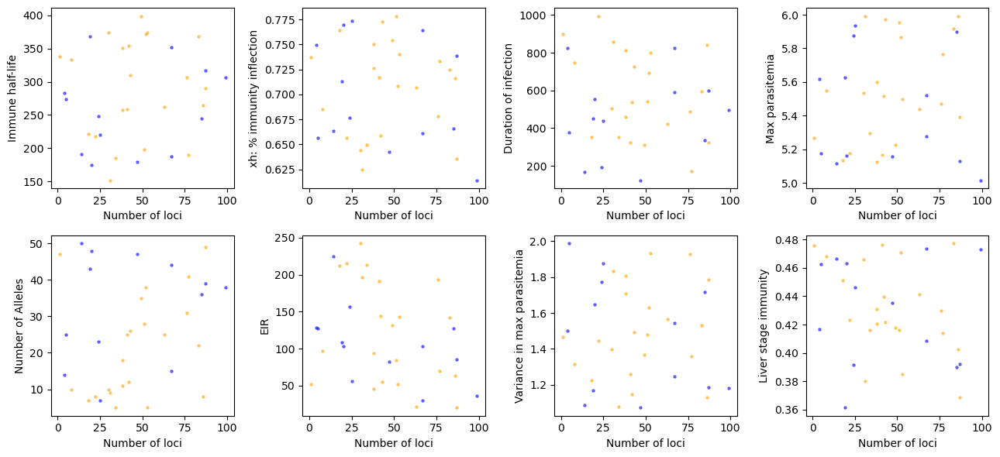

In [40]:
plot_goodbad(good,bad)

In [45]:
trimmed = np.where((params[:,0]<400) & (params[:,0]>150) & (params[:,1]>0.6) & (params[:,1]<0.8) & (params[:,8]>0.35) & (params[:,8]<0.5) & (params[:,7]>1) & (params[:,3]>5) & (params[:,3]<6))[0]

In [46]:
lowess = sm.nonparametric.lowess

def plot(arr,ylab, logy, intervals,n_people,xlab,logx=False):
    '''
    Plots results of banding
    '''
    x = np.repeat(intervals,n_people)
    flattened = arr[:,:].flatten('F')
    smoothed = lowess(flattened, x, return_sorted=True, frac=0.25)
    fig, ax = plt.subplots(tight_layout=True, figsize=(6,4))
    ax.scatter(x, flattened, alpha=0.01)
    ax.plot(smoothed[:,0],smoothed[:,1], color='black')
    if logy == True:
        ax.set_yscale('log')
    if logx == True:
        ax.set_xscale('log')
    ax.set_xlabel(xlab)
    ax.set_ylabel(ylab)

/var/folders/b5/2grxct1x69395r8j6vkk07bc0000gp/T/ipykernel_56179/623297248.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(tight_layout=True, figsize=(6,4))


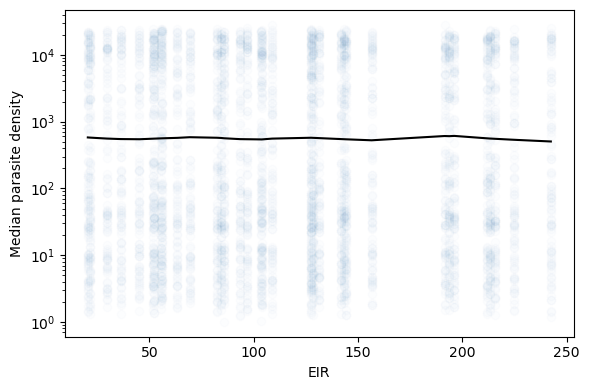

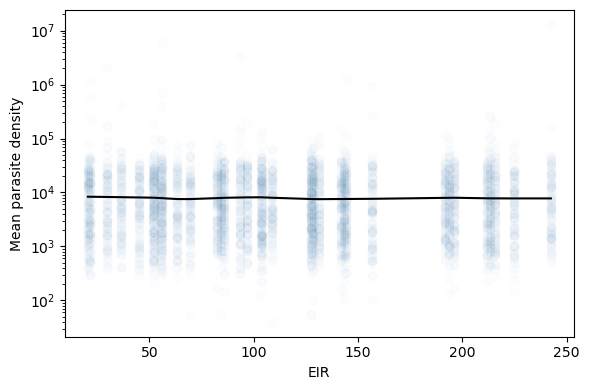

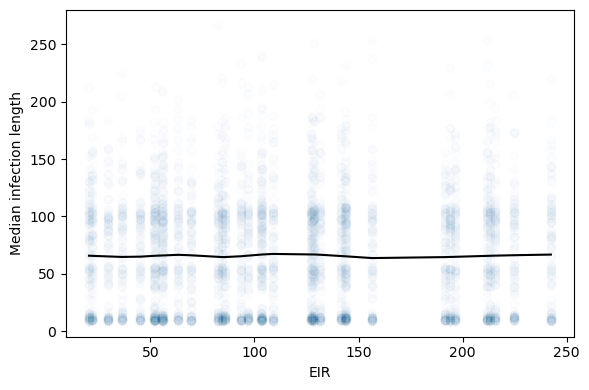

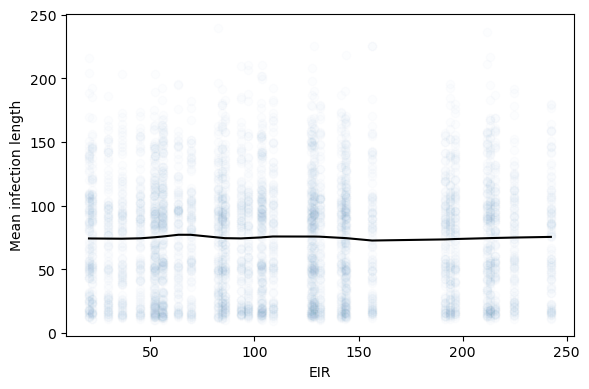

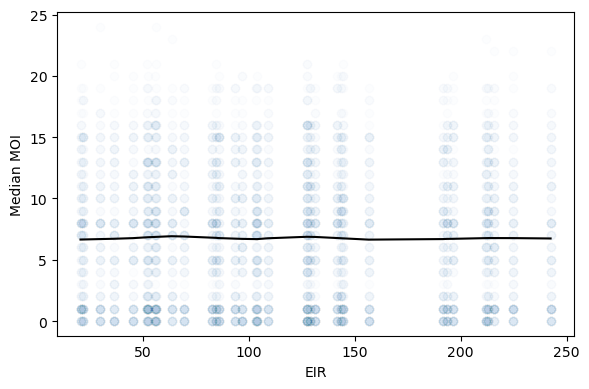

...

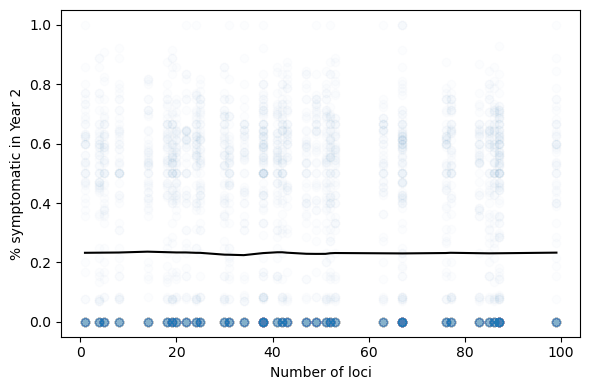

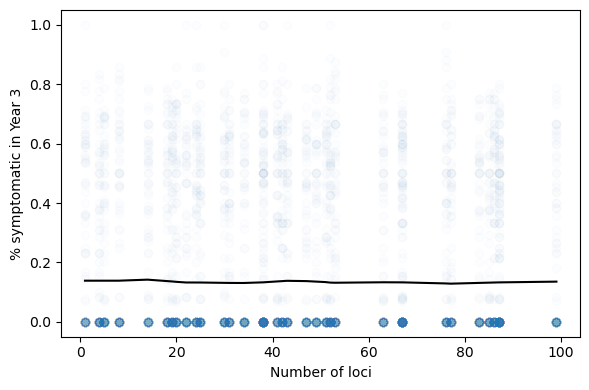

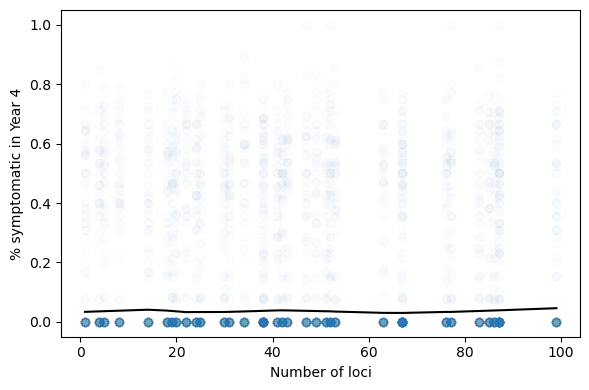

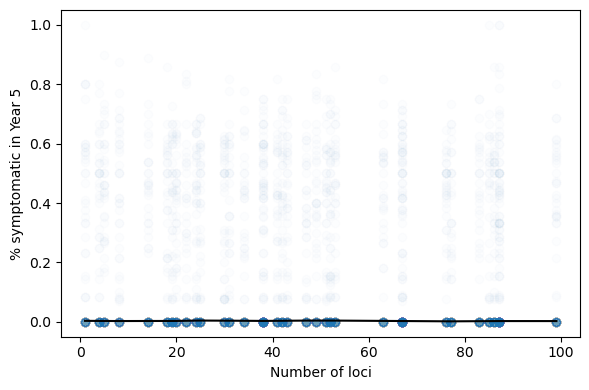

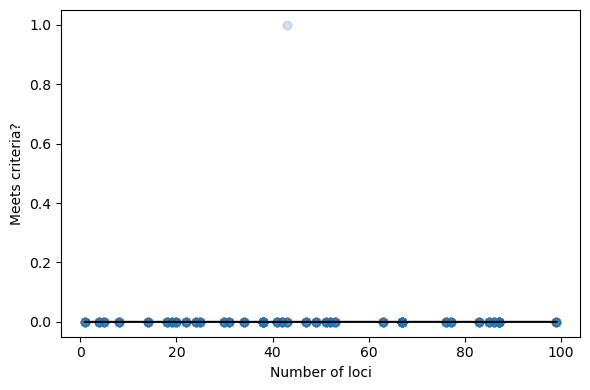

In [47]:
for i in [5,4,6]:
    for row, lab, flag in zip(range(len(outcomeLabels)), outcomeLabels, outcomeLog):
        plot(sims[row,:,trimmed], lab, flag, params[trimmed,i],n_people,pvalues[i])

#### Robustness

In [49]:
defaults = [275,0.7,600,5.5,40,100,20,1.2,0.4]

In [56]:
def simulate_range(ploc, params, n_people,y,defaults):
    n_outcomes = 15 + (5*y)
    outcomes = np.empty((n_outcomes,n_people,len(params)))
    for row in range(len(params)):
        defaults[ploc] = params[row]
        
        t12 = defaults[0]
        xh = defaults[1]
        duration = defaults[2]
        maxP = defaults[3]
        alleles = defaults[4]
        beir = defaults[5]
        nLoci = defaults[6]
        maxPv = defaults[7]
        limm = defaults[8]
    
        eir = beir*limm
        a,w = sTent.create_weight_alleles(nLoci,alleles)
        
        all_parasites, all_immunity, all_strains, all_malaria, all_infections = tent.simulate_cohort(n_people,y,a,w,t12=t12,eir=eir,duration=duration,maxParasitemia=maxP,maxPv=maxPv,xh=xh)
        for person in range(n_people):
            pmatrix = all_parasites[person,...]
            smatrix = all_strains[person]
            malaria = all_malaria[person]
            visits = sTent.get_visits(malaria,30,y)

            Parasitemia, perPositivity = sTent.get_Parasitemia(pmatrix, visits)
            outcomes[0,person,row] = np.median(Parasitemia)
            outcomes[1,person,row] = np.mean(Parasitemia)

            infectionlengths = pt.check_infection_length(smatrix)
            outcomes[2,person,row] = np.median(infectionlengths)
            outcomes[3,person,row] = np.mean(infectionlengths)

            MOI = pt.check_moi(y,smatrix)
            outcomes[4,person,row] = np.median(MOI)
            outcomes[5,person,row] = np.mean(MOI)

            outcomes[6,person,row] = perPositivity
            outcomes[7,person,row] = len(malaria)

            pdensity = pmatrix[-1,:,:].sum(axis=0)
            asymps = sTent.get_asymps(pmatrix,visits,malaria)
            if len(asymps):
                outcomes[8,person,row] = asymps[0]
                if len(malaria):
                    spacing = sTent.get_spacing(asymps,malaria)
                    outcomes[10,person,row] = spacing
                    if spacing > 0:
                        mean,lamp,micro = sTent.get_intermediate_density(visits, asymps,malaria,pmatrix)
                        outcomes[11,person,row] = mean
                        outcomes[12,person,row] = micro
                        outcomes[13,person,row] = lamp
                    else:
                        outcomes[11,person,row] = None
                        outcomes[12,person,row] = None
                        outcomes[13,person,row] = None
                else:
                    outcomes[10,person,row] = None
                    outcomes[11,person,row] = None
                    outcomes[12,person,row] = None
                    outcomes[13,person,row] = None
            else:
                outcomes[8,person,row] = None
                outcomes[10,person,row] = None
                outcomes[11,person,row] = None
                outcomes[12,person,row] = None
                outcomes[13,person,row] = None
            if len(malaria):
                outcomes[9,person,row] = malaria[-1]
            else:
                outcomes[9,person,row] = None

            cases = sTent.get_yearly_cases(malaria,y)
            outcomes[14:14+y,person,row] = cases
            microY,lampY,nPos,pDens = sTent.get_yearly_prevs(y,visits,pmatrix)
            pSymp = sTent.get_symps(cases,nPos)
            outcomes[14+y:14+(y*2),person,row] = microY
            outcomes[14+(y*2):14+(y*3),person,row] = lampY
            outcomes[14+(y*3):14+(y*4),person,row] = pDens
            outcomes[14+(y*4):14+(y*5),person,row] = pSymp
        y_c = outcomes[14+(y*4):14+(y*5),:,row].flatten()
        y_p = outcomes[14+(y*3):14+(y*4),:,row].flatten()
        x = np.broadcast_to(np.arange(1,6),(n_people,5)).T.flatten()
        results_c = scipy.stats.linregress(x,y_c,alternative='less')
        results_p = scipy.stats.linregress(x,y_p,alternative='less')
        final_cases = np.nanmean(outcomes[-2,:,row])
        ilength = np.nanmean(outcomes[3,:,row])
        if results_c.pvalue < sig and results_p.pvalue < sig and final_cases > 0 and ilength > 10:
            outcomes[-1,:,row] = 1
        else:
            outcomes[-1,:,row] = 0
            
    return outcomes

def run_sim(ploc, params):
    outcomes = simulate_range(ploc,params,100,5,defaults)
    for row, lab, flag in zip(range(len(outcomeLabels)), outcomeLabels, outcomeLog):
        plot(outcomes[row,:,:], lab, flag, params,n_people,pvalues[ploc])

In [57]:
eirs = np.linspace(10,250,6)
alleles = np.logspace(1,6,6,base=2)
loci = np.rint(np.logspace(1,6.65,6,base=2))

/Users/cwagner2/Work/projects/malaria/pf-longitudinal-antigens/immunity-sims/pf-tent/code/simulateParams.py:103: RuntimeWarning: invalid value encountered in divide
  symps = np.asarray(cases)/np.asarray(pos)
/var/folders/b5/2grxct1x69395r8j6vkk07bc0000gp/T/ipykernel_56179/623297248.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(tight_layout=True, figsize=(6,4))


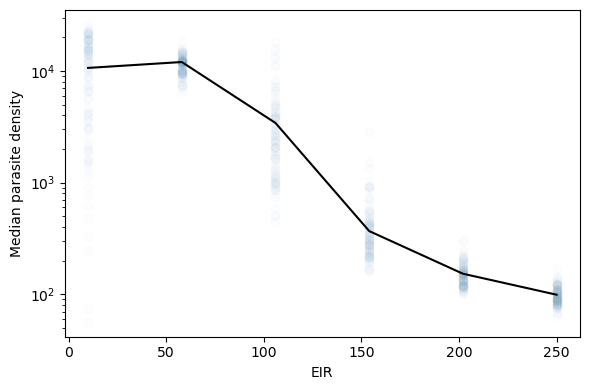

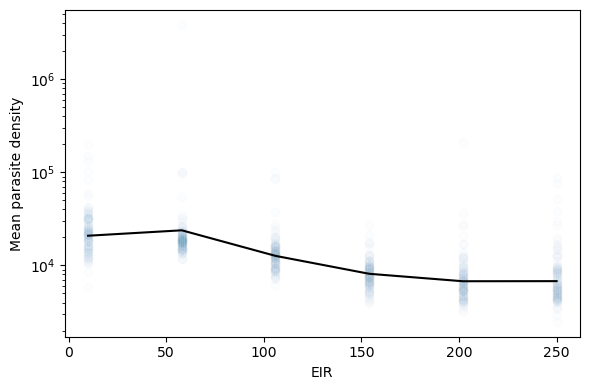

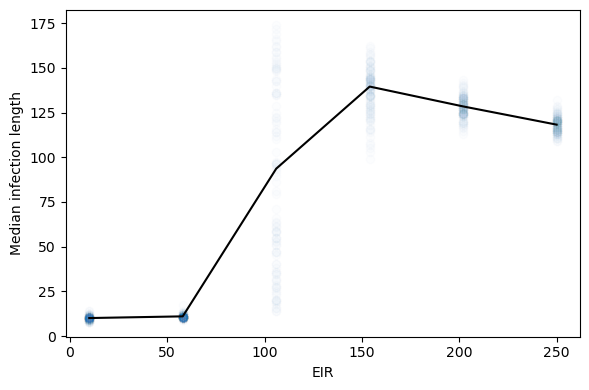

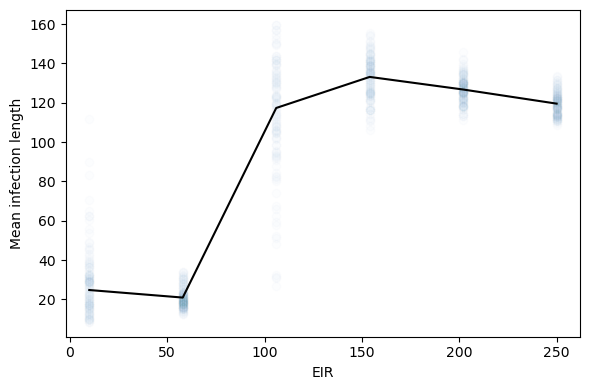

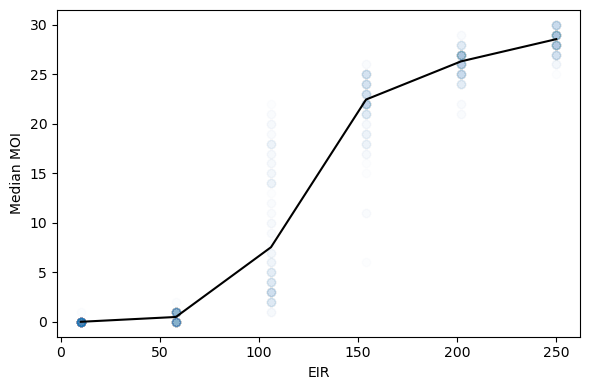

...

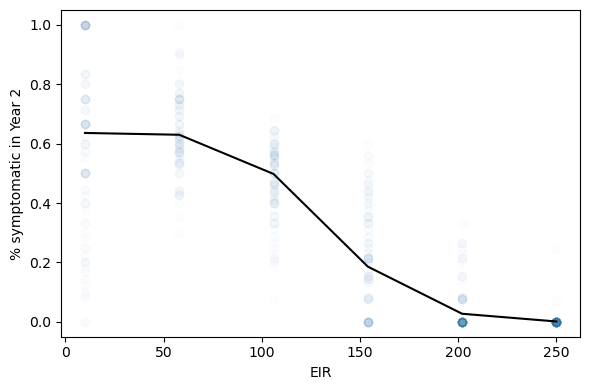

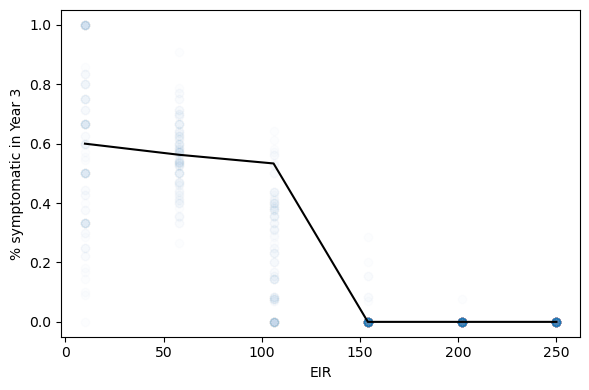

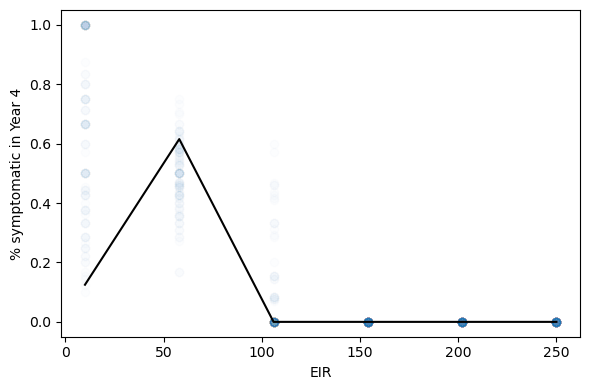

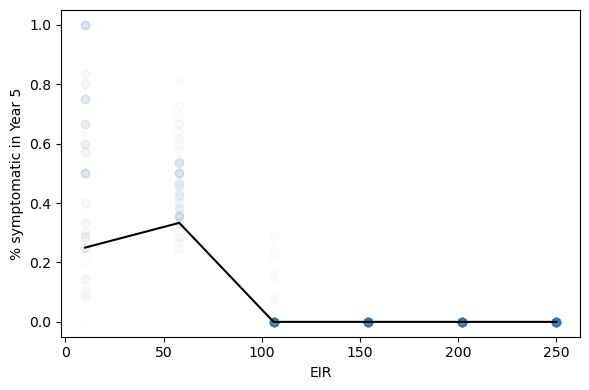

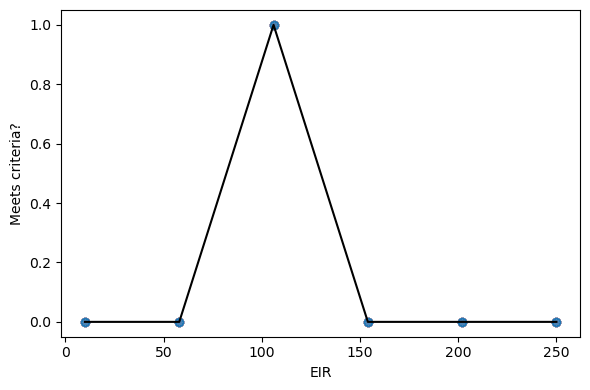

In [58]:
run_sim(5,eirs)

/Users/cwagner2/miniconda3/envs/antigens/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/var/folders/b5/2grxct1x69395r8j6vkk07bc0000gp/T/ipykernel_56179/623297248.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(tight_layout=True, figsize=(6,4))


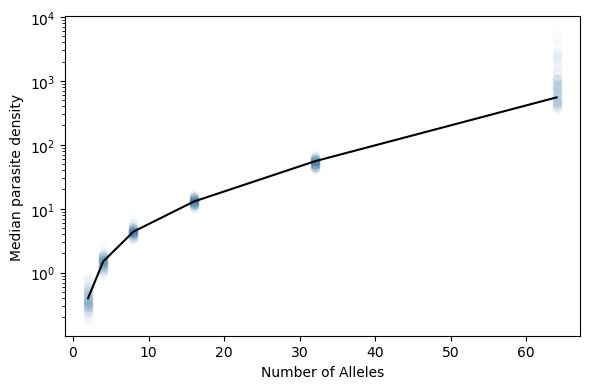

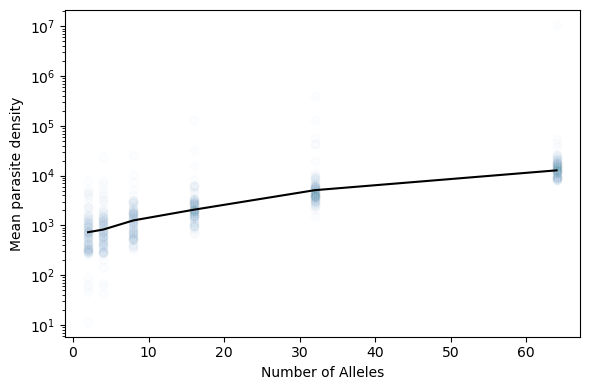

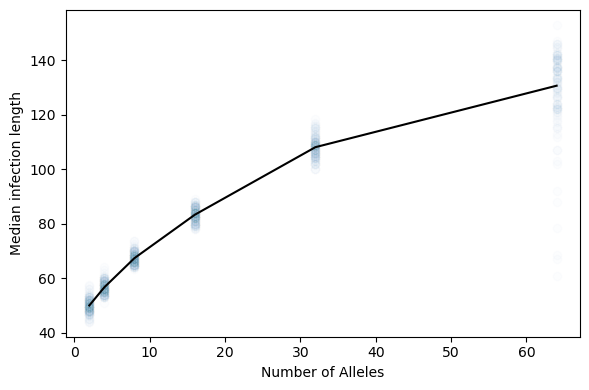

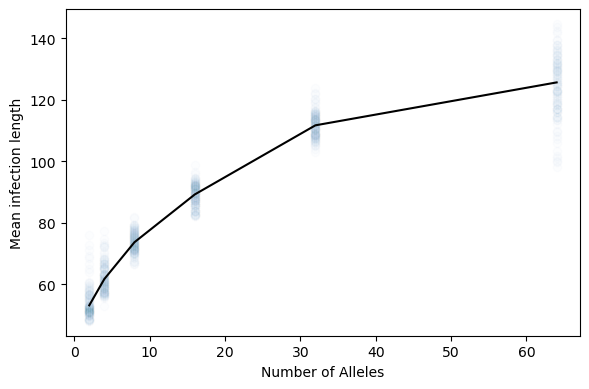

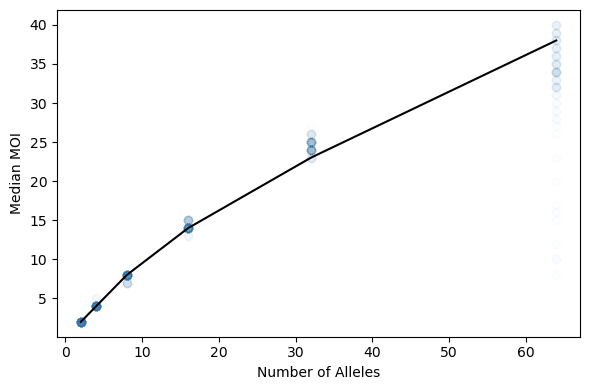

...

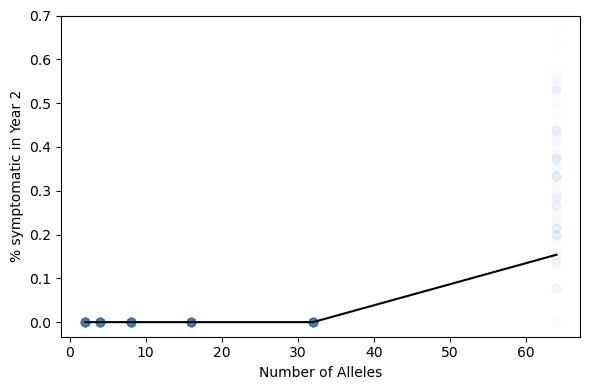

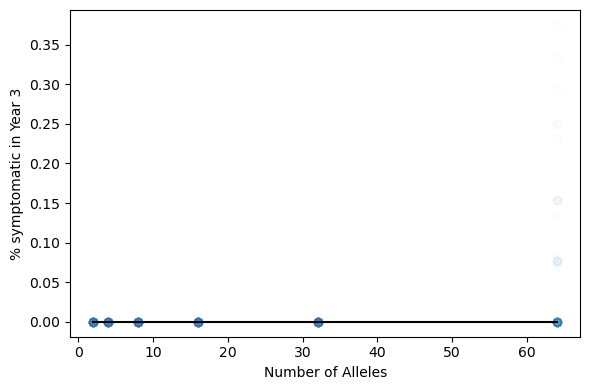

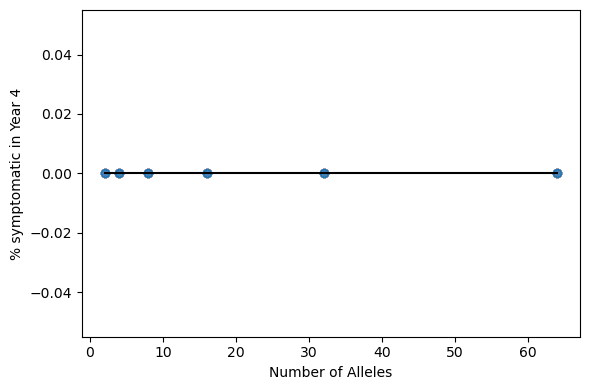

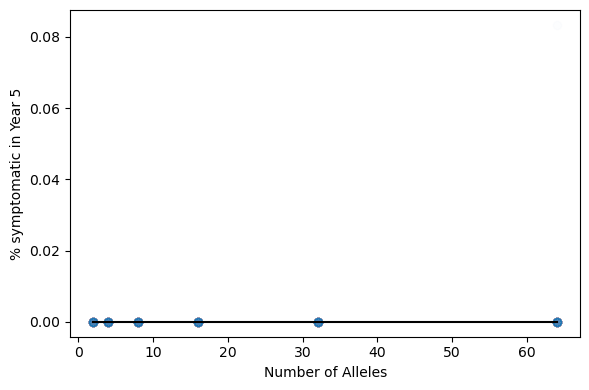

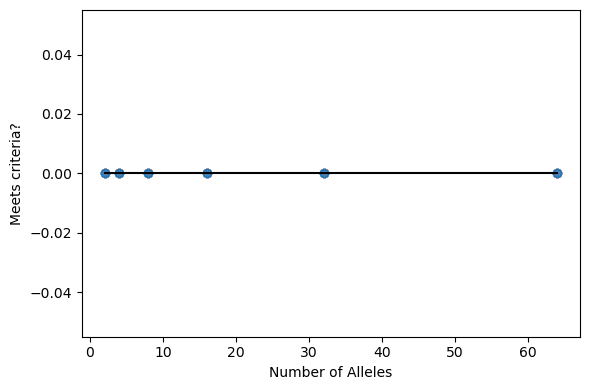

In [59]:
run_sim(4,alleles)

/var/folders/b5/2grxct1x69395r8j6vkk07bc0000gp/T/ipykernel_56179/623297248.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(tight_layout=True, figsize=(6,4))


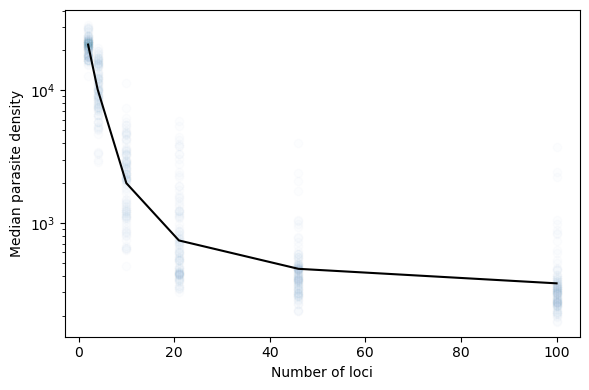

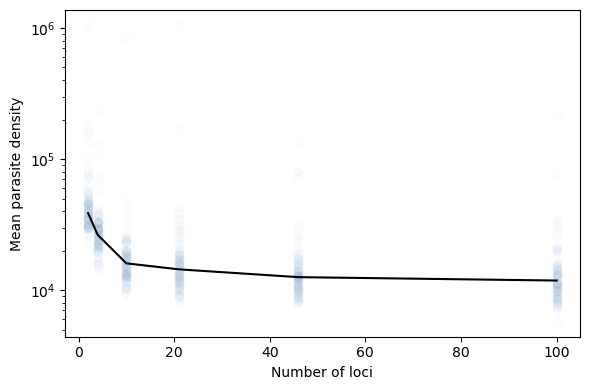

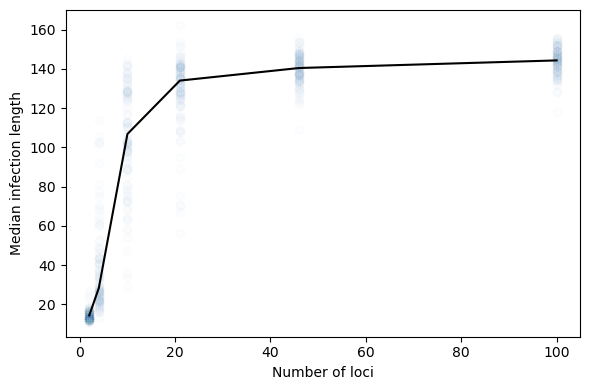

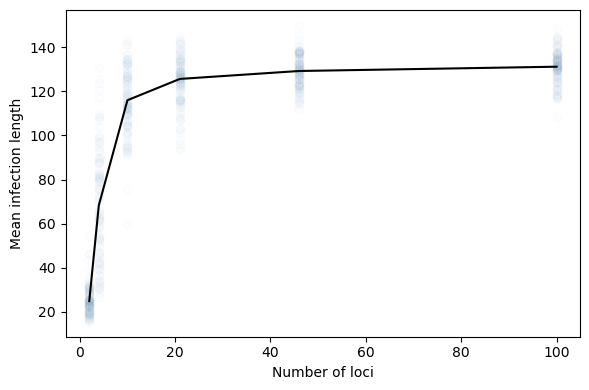

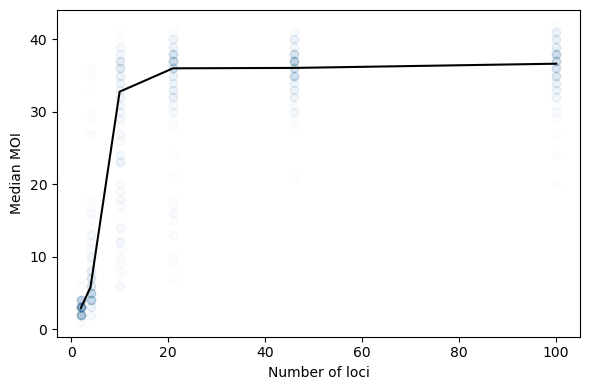

...

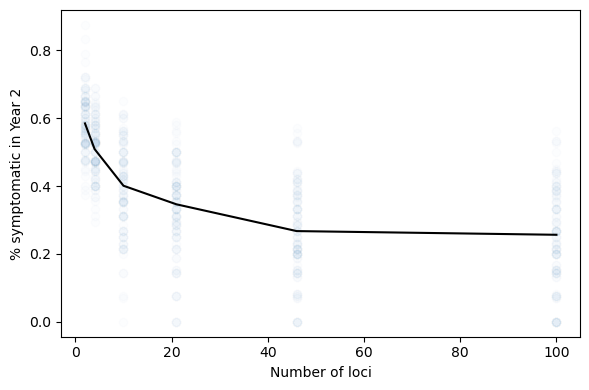

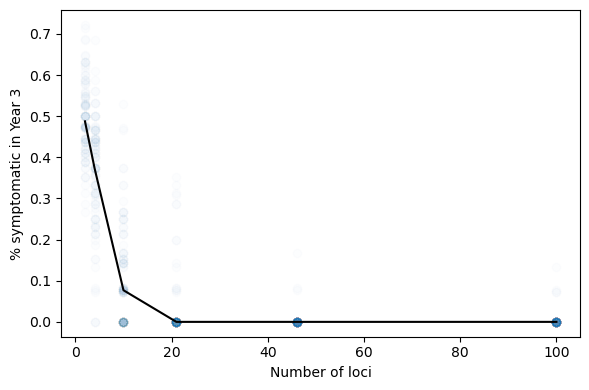

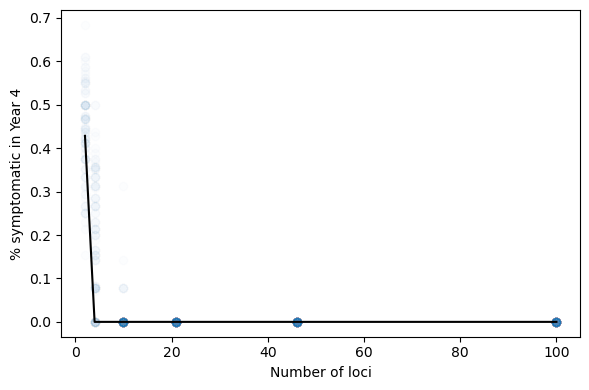

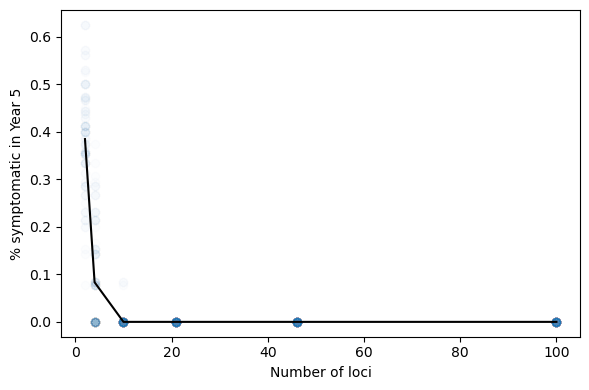

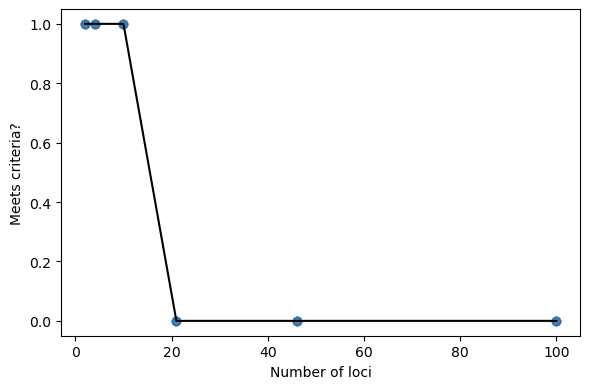

In [60]:
run_sim(6,loci)